<a href="https://colab.research.google.com/github/JohnTong12/Bank-Customer-Churn/blob/main/Churn_Prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Project Goal
- The Goal of the Project is to predict whether a customer will churn in the next 6 months

In [22]:
# from google.colab import drive
# drive.mount('/content/drive',timeout_ms=60000)

#### Problem Definition
- Given a Bank customer, can we build a classification model which can determine whether they will leave in the next 6 months or not?

In [23]:
# !pip install ydata-profiling

In [24]:
# from google.colab import drive
# drive.mount('/content/drive')

### ABOUT THE DATA SET
- The data set was gotten from kaggle :  [Link of the churn kaggle dataset](https://www.kaggle.com/datasets/barelydedicated/bank-customer-churn-modeling/data)

- About the data set features
   * 1. RowNumber: Represents the row number in the dataset.
   * 2. CustomerId: Unique identifier for each customer.
   * 3. Surname: Customer’s last name.
   * 4. CreditScore: Credit score of the customer
   * 5. Geography: Customer’s country of residence
   * 6. Gender: Customer’s gender.
   * 7. Age: Customer’s age.
   * 8. Tenure: Number of years the customer has been with     the bank.   
   * 9. Balance: Account balance of the customer
   * 10. NumOfProducts: Number of bank products the customer uses.
   * 11. HasCrCard: Whether the customer has a credit card (1 for yes, 0 for no).
   * 12. IsActiveMember: Whether the customer is an active member (1 for yes, 0 for no).
   * 13. EstimatedSalary: Estimated salary of the customer
   * 14. Exited: Whether the customer has churned (1 for yes, 0 for no).


##### DATA IMPORTATION

In [25]:
# !pip install category-encoders

In [26]:
## importing necessary libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
from sklearn.model_selection import train_test_split,GridSearchCV
from sklearn.preprocessing import StandardScaler , OneHotEncoder,QuantileTransformer
from imblearn.over_sampling import SMOTE
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import  SVC
from lightgbm import LGBMClassifier
from yellowbrick.target import class_balance
from category_encoders import BinaryEncoder
from yellowbrick.target import class_balance
from yellowbrick.classifier import classification_report
from catboost import CatBoostClassifier
plt.rcParams['axes.facecolor']="#DCDCDC"
sns.set_context("notebook")
import statsmodels as sm
from statsmodels.api import Logit
pd.set_option('display.max_columns',None)
from sklearn.metrics import roc_curve,roc_auc_score



In [27]:
## loading the data
churn_data = pd.read_csv('/content/Churn_Modelling.csv')

In [28]:
## checking the first five rows
churn_data.head()

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,1,15634602,Hargrave,619,France,Female,42,2,0.00,1,1,1,101348.88,1
1,2,15647311,Hill,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0
2,3,15619304,Onio,502,France,Female,42,8,159660.80,3,1,0,113931.57,1
3,4,15701354,Boni,699,France,Female,39,1,0.00,2,0,0,93826.63,0
4,5,15737888,Mitchell,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0


In [29]:
## last five
churn_data.tail()

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
9995,9996,15606229,Obijiaku,771,France,Male,39,5,0.00,2,1,0,96270.64,0
9996,9997,15569892,Johnstone,516,France,Male,35,10,57369.61,1,1,1,101699.77,0
9997,9998,15584532,Liu,709,France,Female,36,7,0.00,1,0,1,42085.58,1
9998,9999,15682355,Sabbatini,772,Germany,Male,42,3,75075.31,2,1,0,92888.52,1
9999,10000,15628319,Walker,792,France,Female,28,4,130142.79,1,1,0,38190.78,0


In [30]:
## checking the data shape
churn_data.shape

(10000, 14)

In [31]:
## cheecking for general info
churn_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 14 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   RowNumber        10000 non-null  int64  
 1   CustomerId       10000 non-null  int64  
 2   Surname          10000 non-null  object 
 3   CreditScore      10000 non-null  int64  
 4   Geography        10000 non-null  object 
 5   Gender           10000 non-null  object 
 6   Age              10000 non-null  int64  
 7   Tenure           10000 non-null  int64  
 8   Balance          10000 non-null  float64
 9   NumOfProducts    10000 non-null  int64  
 10  HasCrCard        10000 non-null  int64  
 11  IsActiveMember   10000 non-null  int64  
 12  EstimatedSalary  10000 non-null  float64
 13  Exited           10000 non-null  int64  
dtypes: float64(2), int64(9), object(3)
memory usage: 1.1+ MB


In [32]:
## validation the data types
churn_data.dtypes

,0
RowNumber,int64
CustomerId,int64
Surname,object
CreditScore,int64
Geography,object
Gender,object
Age,int64
Tenure,int64
Balance,float64
NumOfProducts,int64


In [33]:
## column names
churn_data.columns.to_list()

['RowNumber',
 'CustomerId',
 'Surname',
 'CreditScore',
 'Geography',
 'Gender',
 'Age',
 'Tenure',
 'Balance',
 'NumOfProducts',
 'HasCrCard',
 'IsActiveMember',
 'EstimatedSalary',
 'Exited']

In [34]:
## checking for data describtion  ~ descriptive stats
churn_data.describe().T

,count,mean,std,min,25%,50%,75%,max
RowNumber,10000.0,5.000500e+03,2886.895680,1.00,2500.75,5.000500e+03,7.500250e+03,10000.00
CustomerId,10000.0,1.569094e+07,71936.186123,15565701.00,15628528.25,1.569074e+07,1.575323e+07,15815690.00
CreditScore,10000.0,6.505288e+02,96.653299,350.00,584.00,6.520000e+02,7.180000e+02,850.00
Age,10000.0,3.892180e+01,10.487806,18.00,32.00,3.700000e+01,4.400000e+01,92.00
Tenure,10000.0,5.012800e+00,2.892174,0.00,3.00,5.000000e+00,7.000000e+00,10.00
Balance,10000.0,7.648589e+04,62397.405202,0.00,0.00,9.719854e+04,1.276442e+05,250898.09
NumOfProducts,10000.0,1.530200e+00,0.581654,1.00,1.00,1.000000e+00,2.000000e+00,4.00
HasCrCard,10000.0,7.055000e-01,0.455840,0.00,0.00,1.000000e+00,1.000000e+00,1.00
IsActiveMember,10000.0,5.151000e-01,0.499797,0.00,0.00,1.000000e+00,1.000000e+00,1.00
EstimatedSalary,10000.0,1.000902e+05,57510.492818,11.58,51002.11,1.001939e+05,1.493882e+05,199992.48


#### observations made from the numeric data
* There 20.37% customer  churn rate whereas  79.63% customers stayed
* The customer base shows high financial diversity (wide range in balances and salaries)
* Large spread in balances and salaries indicates diverse customer base
* Most customers have only 1-2 products
* Only 51.51% are active members
* Mean age is 38.9 years

In [35]:
### checking for missing values
churn_data.isnull().mean()*100

,0
RowNumber,0.0
CustomerId,0.0
Surname,0.0
CreditScore,0.0
Geography,0.0
Gender,0.0
Age,0.0
Tenure,0.0
Balance,0.0
NumOfProducts,0.0


In [36]:
## checking for duplicates
churn_data.duplicated(keep='first').sum()

0

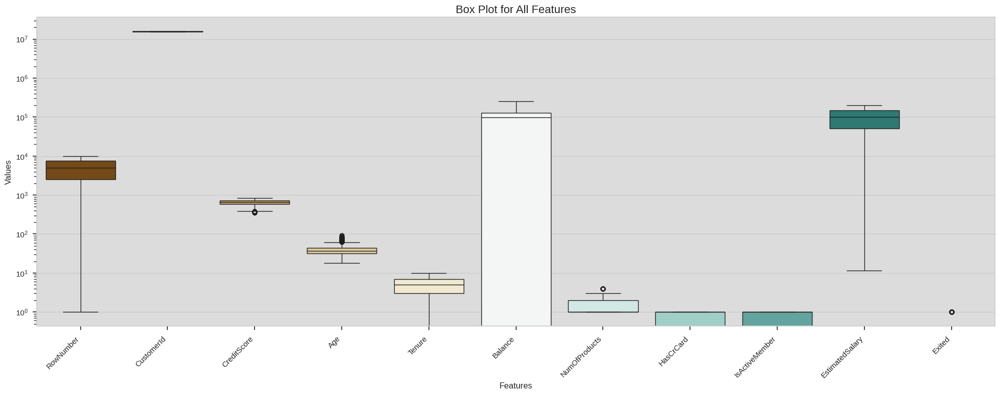

In [37]:
# Creating a boxplot with logarithmic scale for the y-axis
plt.figure(figsize=(20, 8))
ax = sns.boxplot(data=churn_data, palette='BrBG')

# Set plot title and labels
plt.title('Box Plot for All Features', fontsize=16)
plt.xlabel('Features')
plt.ylabel('Values')

# Set y-axis to logarithmic scale
ax.set_yscale('log')

# Improve layout
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Save and show plot
plt.show()

#### Key insights from the visual
* it seems like the data doesnot have alot of outliers
* Age and credit score seem to have
* Num products seem to als one


#### EXPLRATORY DATA ANALYSIS

In [38]:
### lets start by building the pandas profiler
## initializing the profile report
from ydata_profiling import ProfileReport
profile_report =  ProfileReport(
    churn_data,
    title="Customized Report",
    minimal=False,
    explorative=True,


)

profile_report.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### key observations of the pandas Profiler
* Age has a moderate positive correlation (0.375)
* Number of Products has a notable correlation (0.387)
* There is aPositive correlation between Age and Balance , as the customerss get older , there account balances tend to increase
* Longer Tenure customerss usallly have higher balances

### DATA DISTRIBUTIONS



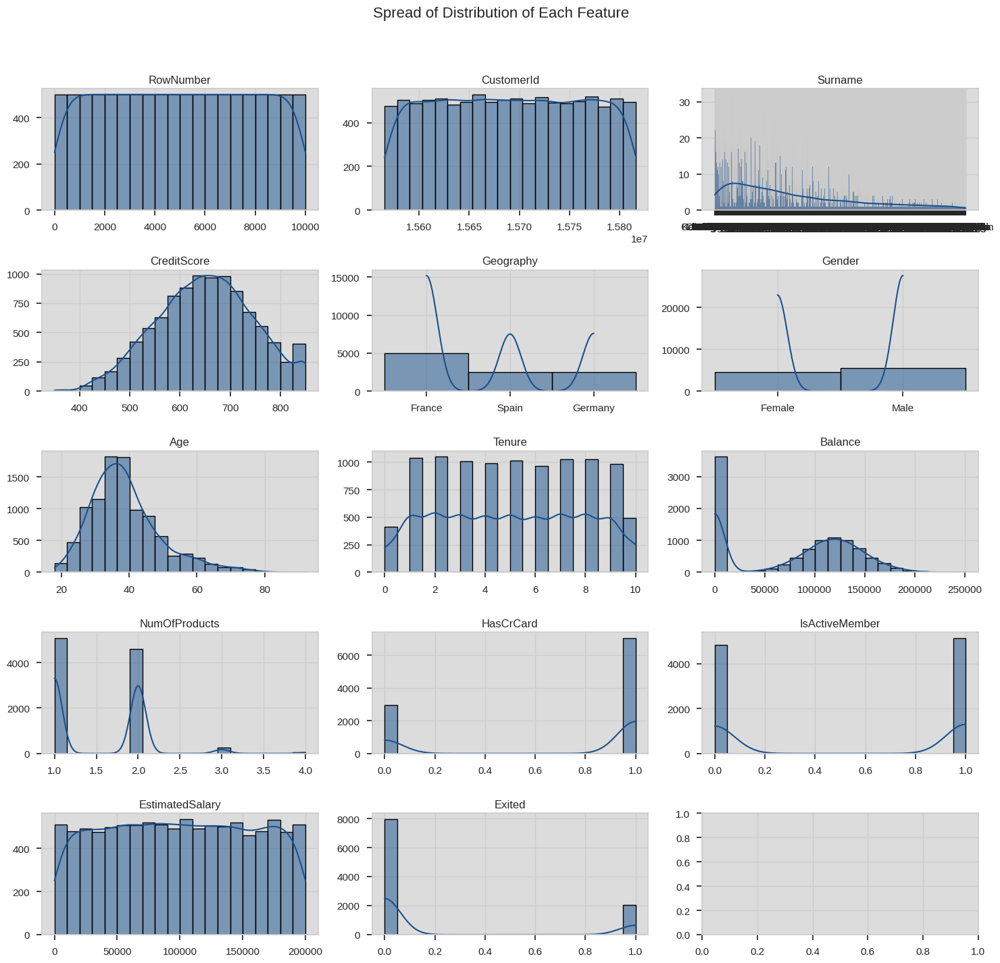

In [39]:
# Generating plots
fig, axes = plt.subplots(5, 3, figsize=(15, 15))  # Adjust number of rows and columns as needed
fig.suptitle('Spread of Distribution of Each Feature', fontsize=16)

# Flatten the axes array for easy iteration
axes = axes.flatten()

for i, column in enumerate(churn_data.columns):
    if i < len(axes):  # Ensure we don't try to plot more columns than we have axes for
        sns.histplot(churn_data[column], bins=20, kde=True, ax=axes[i], color='#195190')
        axes[i].set_title(column)
        axes[i].set_xlabel('')
        axes[i].set_ylabel('')

# Adjust layout
plt.tight_layout(rect=[0, 0.03, 1, 0.95])

# Save and show plot
plt.show()

### key observations from the Numeric plots
* These features are evenly distributed, indicating that they are unique identifiers and likely irrelevant for predictive modeling or analysis.
* he data is normally distributed with a slight left skew. Most customers have credit scores between 500 and 750, with a few outliers on both ends.
* The majority of customers are from France, followed by Spain and Germany.
* There is a nearly equal distribution between male and female customers
* The distribution is slightly right-skewed, with most customers aged between 25 and 50
* There are fewer older customers (above 60)
* The tenure appears evenly distributed across most levels, but the distribution has slight
* The balance shows a bimodal distribution, with a significant number of customers at zero balance.

### Class Imbalance

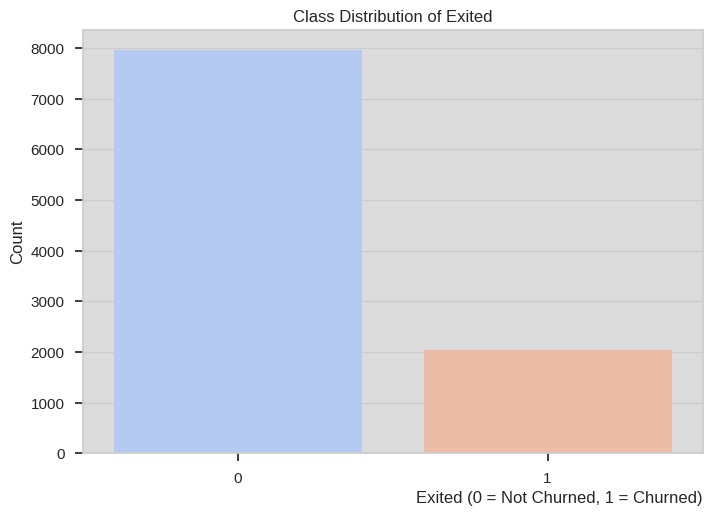

In [40]:

# Bar plot for `Exited` distribution
sns.countplot(data=churn_data, x='Exited', palette='coolwarm')
plt.title('Class Distribution of Exited')
plt.xlabel('Exited (0 = Not Churned, 1 = Churned)',loc='right')
plt.ylabel('Count')
plt.show()

In [41]:
## percentage distribution
# Percentage distribution
churn_data['Exited'].value_counts(normalize=True) * 100


,proportion
Exited,
0,79.63
1,20.37


In [42]:
## diplaying data
churn_data.dtypes

,0
RowNumber,int64
CustomerId,int64
Surname,object
CreditScore,int64
Geography,object
Gender,object
Age,int64
Tenure,int64
Balance,float64
NumOfProducts,int64


In [43]:
####  FEATURE EGINEERING

def create_interaction_features(df):

    # Create a copy of the dataframe
    df_interactions = df.copy()

    # 1. Age-based Interactions
    df_interactions['Age_Balance_Interaction'] = df['Age'] * df['Balance']
    df_interactions['Age_NumProducts_Interaction'] = df['Age'] * df['NumOfProducts']

    # 2. Credit Score Interactions
    df_interactions['CreditScore_Balance_Interaction'] = df['CreditScore'] * df['Balance']
    df_interactions['CreditScore_EstimatedSalary_Interaction'] = df['CreditScore'] * df['EstimatedSalary']

    # 3. Tenure-based Interactions
    df_interactions['Tenure_NumProducts_Interaction'] = df['Tenure'] * df['NumOfProducts']
    df_interactions['Tenure_Balance_Interaction'] = df['Tenure'] * df['Balance']

    # 4. Categorical Interactions
    # One-hot encode categorical variables first
    categorical_features = ['Gender', 'Geography', 'HasCrCard', 'IsActiveMember','NumOfProducts']
    df_encoded = pd.get_dummies(df, columns=categorical_features, prefix='', prefix_sep='')

    # Interaction with Age
    for cat_col in df_encoded.columns:
        if cat_col.startswith(tuple(categorical_features)):
            df_interactions[f'Age_{cat_col}_Interaction'] = df['Age'] * df_encoded[cat_col]

    # 5. Polynomial Features
    df_interactions['Age_Squared'] = df['Age'] ** 2
    df_interactions['Balance_Squared'] = df['Balance'] ** 2
    df_interactions['CreditScore_Squared'] = df['CreditScore'] ** 2

    # 6. Logarithmic Transformations (adding small constant to avoid log(0))
    df_interactions['Log_Balance'] = np.log1p(df['Balance'])
    df_interactions['Log_EstimatedSalary'] = np.log1p(df['EstimatedSalary'])

    # 7. Ratio-based Features
    df_interactions['Balance_to_EstimatedSalary_Ratio'] = df['Balance'] / (df['EstimatedSalary'] + 1)
    df_interactions['NumProducts_to_Tenure_Ratio'] = df['NumOfProducts'] / (df['Tenure'] + 1)

    ## BalanceCategory featur
    df_interactions['BalanceCategory'] = df_interactions['Balance'].apply(lambda x: 'Zero Balance' if x == 0 else 'Non-Zero Balance')

    ## Region churn Rate
    df_interactions['RegionChurnRate'] = df_interactions.groupby('Geography')['Exited'].transform('mean')

    ## Gender churn rate
    df_interactions['RegionChurnRate'] = df_interactions.groupby('Gender')['Exited'].transform('mean')




    return df_interactions


    # Create interaction features
churn_data_egineered = create_interaction_features(churn_data)



In [44]:
## checking the data
churn_data_egineered.head()

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Age_Balance_Interaction,Age_NumProducts_Interaction,CreditScore_Balance_Interaction,CreditScore_EstimatedSalary_Interaction,Tenure_NumProducts_Interaction,Tenure_Balance_Interaction,Age_Squared,Balance_Squared,CreditScore_Squared,Log_Balance,Log_EstimatedSalary,Balance_to_EstimatedSalary_Ratio,NumProducts_to_Tenure_Ratio,BalanceCategory,RegionChurnRate
0,1,15634602,Hargrave,619,France,Female,42,2,0.00,1,1,1,101348.88,1,0.00,42,0.000000e+00,62734956.72,2,0.00,1764,0.000000e+00,383161,0.000000,11.526334,0.000000,0.333333,Zero Balance,0.250715
1,2,15647311,Hill,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0,3436122.26,41,5.095518e+07,68425888.64,1,83807.86,1681,7.023757e+09,369664,11.336294,11.631096,0.744670,0.500000,Non-Zero Balance,0.250715
2,3,15619304,Onio,502,France,Female,42,8,159660.80,3,1,0,113931.57,1,6705753.60,126,8.014972e+07,57193648.14,24,1277286.40,1764,2.549157e+10,252004,11.980813,11.643362,1.401362,0.333333,Non-Zero Balance,0.250715
3,4,15701354,Boni,699,France,Female,39,1,0.00,2,0,0,93826.63,0,0.00,78,0.000000e+00,65584814.37,2,0.00,1521,0.000000e+00,488601,0.000000,11.449215,0.000000,1.000000,Zero Balance,0.250715
4,5,15737888,Mitchell,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0,5396965.26,43,1.066842e+08,67221485.00,2,251021.64,1849,1.575297e+10,722500,11.740155,11.278280,1.587035,0.333333,Non-Zero Balance,0.250715


In [45]:
## checking for the shape now
churn_data_egineered.shape

(10000, 29)

In [46]:
## dropping features that will not make sense  as they dont meaning for modelling
churn_data_egineered = churn_data_egineered.drop(columns=['RowNumber','CustomerId','Surname'])

In [47]:
## churn_data
churn_data_egineered

,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Age_Balance_Interaction,Age_NumProducts_Interaction,CreditScore_Balance_Interaction,CreditScore_EstimatedSalary_Interaction,Tenure_NumProducts_Interaction,Tenure_Balance_Interaction,Age_Squared,Balance_Squared,CreditScore_Squared,Log_Balance,Log_EstimatedSalary,Balance_to_EstimatedSalary_Ratio,NumProducts_to_Tenure_Ratio,BalanceCategory,RegionChurnRate
0,619,France,Female,42,2,0.00,1,1,1,101348.88,1,0.00,42,0.000000e+00,62734956.72,2,0.00,1764,0.000000e+00,383161,0.000000,11.526334,0.000000,0.333333,Zero Balance,0.250715
1,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0,3436122.26,41,5.095518e+07,68425888.64,1,83807.86,1681,7.023757e+09,369664,11.336294,11.631096,0.744670,0.500000,Non-Zero Balance,0.250715
2,502,France,Female,42,8,159660.80,3,1,0,113931.57,1,6705753.60,126,8.014972e+07,57193648.14,24,1277286.40,1764,2.549157e+10,252004,11.980813,11.643362,1.401362,0.333333,Non-Zero Balance,0.250715
3,699,France,Female,39,1,0.00,2,0,0,93826.63,0,0.00,78,0.000000e+00,65584814.37,2,0.00,1521,0.000000e+00,488601,0.000000,11.449215,0.000000,1.000000,Zero Balance,0.250715
4,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0,5396965.26,43,1.066842e+08,67221485.00,2,251021.64,1849,1.575297e+10,722500,11.740155,11.278280,1.587035,0.333333,Non-Zero Balance,0.250715
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,771,France,Male,39,5,0.00,2,1,0,96270.64,0,0.00,78,0.000000e+00,74224663.44,10,0.00,1521,0.000000e+00,594441,0.000000,11.474929,0.000000,0.333333,Zero Balance,0.164559
9996,516,France,Male,35,10,57369.61,1,1,1,101699.77,0,2007936.35,35,2.960272e+07,52477081.32,10,573696.10,1225,3.291272e+09,266256,10.957287,11.529790,0.564102,0.090909,Non-Zero Balance,0.164559
9997,709,France,Female,36,7,0.00,1,0,1,42085.58,1,0.00,36,0.000000e+00,29838676.22,7,0.00,1296,0.000000e+00,502681,0.000000,10.647484,0.000000,0.125000,Zero Balance,0.250715
9998,772,Germany,Male,42,3,75075.31,2,1,0,92888.52,1,3153163.02,84,5.795814e+07,71709937.44,6,225225.93,1764,5.636302e+09,595984,11.226260,11.439166,0.808222,0.500000,Non-Zero Balance,0.164559


In [48]:
## checking for info
churn_data_egineered.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 26 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   CreditScore                              10000 non-null  int64  
 1   Geography                                10000 non-null  object 
 2   Gender                                   10000 non-null  object 
 3   Age                                      10000 non-null  int64  
 4   Tenure                                   10000 non-null  int64  
 5   Balance                                  10000 non-null  float64
 6   NumOfProducts                            10000 non-null  int64  
 7   HasCrCard                                10000 non-null  int64  
 8   IsActiveMember                           10000 non-null  int64  
 9   EstimatedSalary                          10000 non-null  float64
 10  Exited                                   10000 

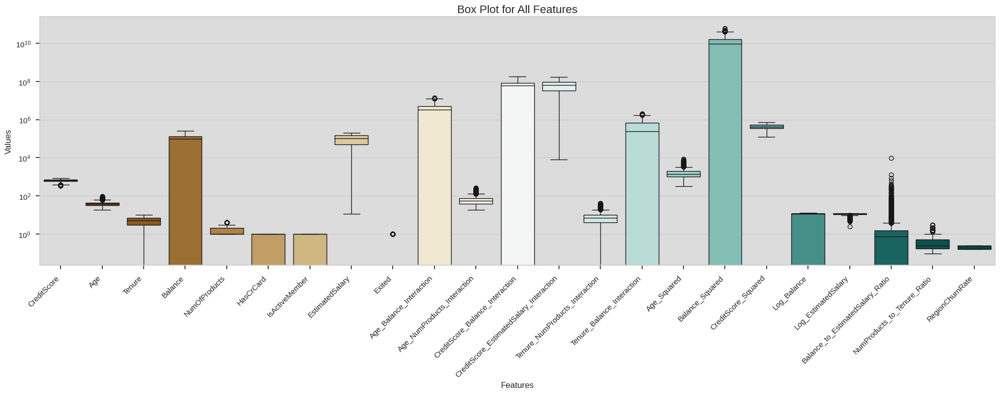

In [49]:
## data distribution
# Creating a boxplot with logarithmic scale for the y-axis
plt.figure(figsize=(20, 8))
ax = sns.boxplot(data=churn_data_egineered, palette='BrBG')

# Set plot title and labels
plt.title('Box Plot for All Features', fontsize=16)
plt.xlabel('Features')
plt.ylabel('Values')

# Set y-axis to logarithmic scale
ax.set_yscale('log')

# Improve layout
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Save and show plot
plt.show()

### Key Insights
* Interaction terms like CreditScore_Balance_Interaction, NumProducts_to_Tenure_Ratio exhibit noticeable outliers.
* Interaction terms like Age_Balance_Interaction, CreditScore_EstimatedSalary_Ratio, and squared terms (e.g., Age_Squared, Balance_Squared) appear to extend the feature space by capturing nonlinear or combined effects.


### The Pandas Profiler to explain interactions saving us time


In [50]:
# ### lets start by building the pandas profiler
profile_report =  ProfileReport(
    churn_data_egineered,
    title="Customized Report",
    minimal=False,
    explorative=True,


)

profile_report.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [51]:
# churn_data_egineered.to_csv('Churn_data_1.csv', index=False)  # Save to CSV
# churn_data_1 = pd.read_csv(r'D:\python_data_analysis\Analytics\Practice\projects\Churn_data_1.csv')  # Reload the CSV
# profile_report =  ProfileReport(
#     churn_data_1,
#     title="Customized Report",
#     minimal=False,
#     explorative=True,


# )

# profile_report.to_notebook_iframe()

In [52]:
churn_data_egineered

,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Age_Balance_Interaction,Age_NumProducts_Interaction,CreditScore_Balance_Interaction,CreditScore_EstimatedSalary_Interaction,Tenure_NumProducts_Interaction,Tenure_Balance_Interaction,Age_Squared,Balance_Squared,CreditScore_Squared,Log_Balance,Log_EstimatedSalary,Balance_to_EstimatedSalary_Ratio,NumProducts_to_Tenure_Ratio,BalanceCategory,RegionChurnRate
0,619,France,Female,42,2,0.00,1,1,1,101348.88,1,0.00,42,0.000000e+00,62734956.72,2,0.00,1764,0.000000e+00,383161,0.000000,11.526334,0.000000,0.333333,Zero Balance,0.250715
1,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0,3436122.26,41,5.095518e+07,68425888.64,1,83807.86,1681,7.023757e+09,369664,11.336294,11.631096,0.744670,0.500000,Non-Zero Balance,0.250715
2,502,France,Female,42,8,159660.80,3,1,0,113931.57,1,6705753.60,126,8.014972e+07,57193648.14,24,1277286.40,1764,2.549157e+10,252004,11.980813,11.643362,1.401362,0.333333,Non-Zero Balance,0.250715
3,699,France,Female,39,1,0.00,2,0,0,93826.63,0,0.00,78,0.000000e+00,65584814.37,2,0.00,1521,0.000000e+00,488601,0.000000,11.449215,0.000000,1.000000,Zero Balance,0.250715
4,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0,5396965.26,43,1.066842e+08,67221485.00,2,251021.64,1849,1.575297e+10,722500,11.740155,11.278280,1.587035,0.333333,Non-Zero Balance,0.250715
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,771,France,Male,39,5,0.00,2,1,0,96270.64,0,0.00,78,0.000000e+00,74224663.44,10,0.00,1521,0.000000e+00,594441,0.000000,11.474929,0.000000,0.333333,Zero Balance,0.164559
9996,516,France,Male,35,10,57369.61,1,1,1,101699.77,0,2007936.35,35,2.960272e+07,52477081.32,10,573696.10,1225,3.291272e+09,266256,10.957287,11.529790,0.564102,0.090909,Non-Zero Balance,0.164559
9997,709,France,Female,36,7,0.00,1,0,1,42085.58,1,0.00,36,0.000000e+00,29838676.22,7,0.00,1296,0.000000e+00,502681,0.000000,10.647484,0.000000,0.125000,Zero Balance,0.250715
9998,772,Germany,Male,42,3,75075.31,2,1,0,92888.52,1,3153163.02,84,5.795814e+07,71709937.44,6,225225.93,1764,5.636302e+09,595984,11.226260,11.439166,0.808222,0.500000,Non-Zero Balance,0.164559


In [53]:
churn_data_egineered.describe().T

,count,mean,std,min,25%,50%,75%,max
CreditScore,10000.0,6.505288e+02,9.665330e+01,350.000000,5.840000e+02,6.520000e+02,7.180000e+02,8.500000e+02
Age,10000.0,3.892180e+01,1.048781e+01,18.000000,3.200000e+01,3.700000e+01,4.400000e+01,9.200000e+01
Tenure,10000.0,5.012800e+00,2.892174e+00,0.000000,3.000000e+00,5.000000e+00,7.000000e+00,1.000000e+01
Balance,10000.0,7.648589e+04,6.239741e+04,0.000000,0.000000e+00,9.719854e+04,1.276442e+05,2.508981e+05
NumOfProducts,10000.0,1.530200e+00,5.816544e-01,1.000000,1.000000e+00,1.000000e+00,2.000000e+00,4.000000e+00
HasCrCard,10000.0,7.055000e-01,4.558405e-01,0.000000,0.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00
IsActiveMember,10000.0,5.151000e-01,4.997969e-01,0.000000,0.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00
EstimatedSalary,10000.0,1.000902e+05,5.751049e+04,11.580000,5.100211e+04,1.001939e+05,1.493882e+05,1.999925e+05
Exited,10000.0,2.037000e-01,4.027686e-01,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00
Age_Balance_Interaction,10000.0,2.995492e+06,2.646813e+06,0.000000,0.000000e+00,3.360211e+06,4.911035e+06,1.379695e+07


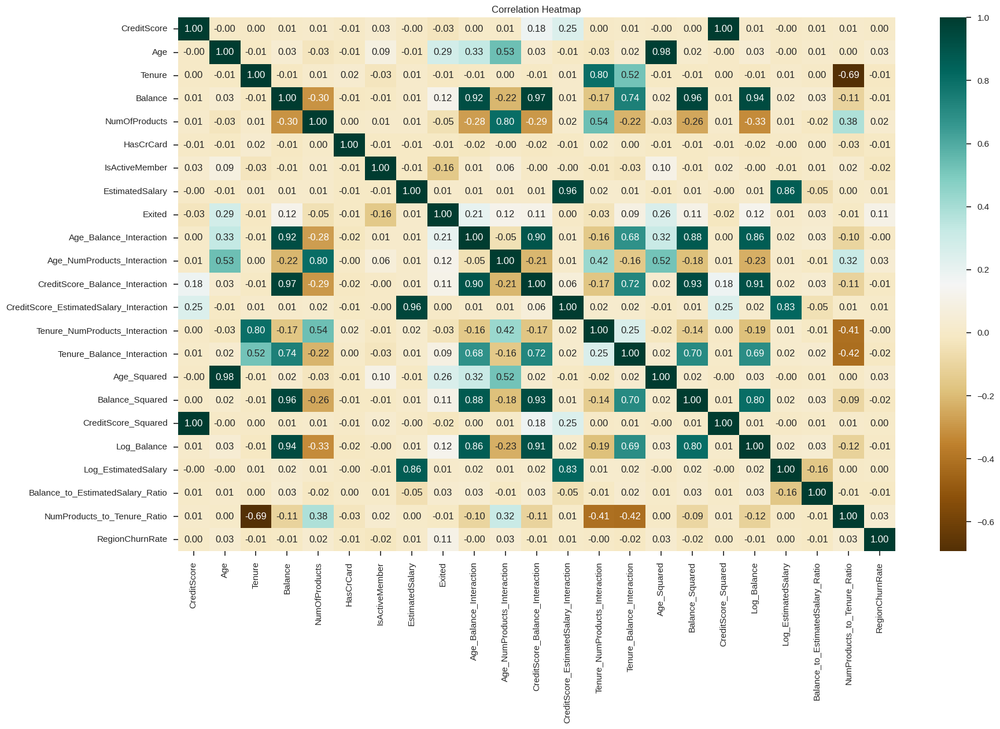

In [54]:
### correlation plot
correlation_matrix = churn_data_egineered.corr(numeric_only=True)
# Create a heatmap
plt.figure(figsize=(20, 12))
sns.heatmap(correlation_matrix, annot=True, cmap="BrBG", fmt=".2f", cbar=True)
plt.title("Correlation Heatmap")
plt.show()

#### Key Insights
* RegionChurnRate shows negligible correlation with other features, suggesting that customer churn may not vary significantly by geographic region.
* Balance also shows a weak negative correlation (-0.17)
* the correlations among most original predictors are near zero. This ensures models won’t suffer heavily from multicollinearity.



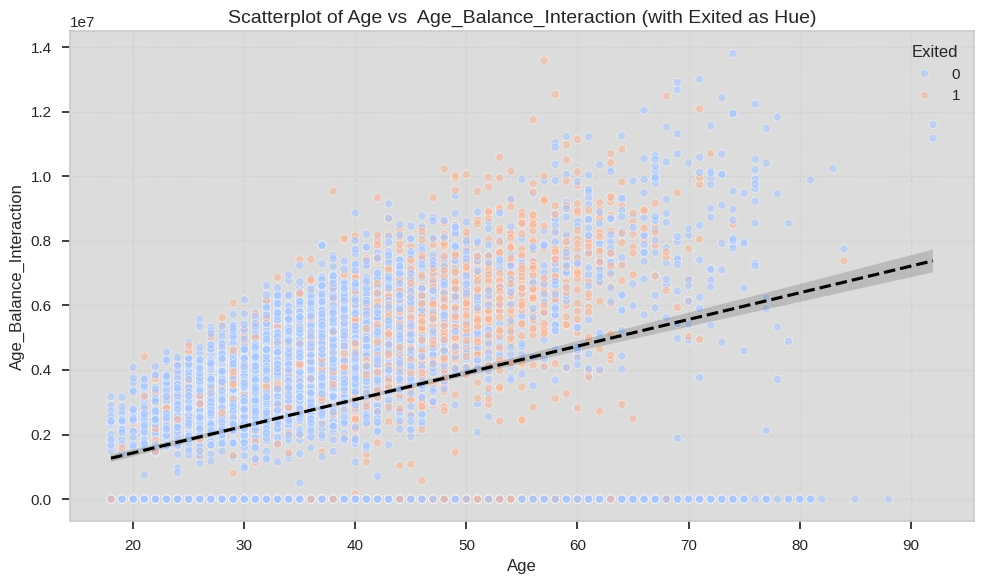

In [55]:
### Note

# Scatterplot for Age vs Balance with a focus on their interaction
plt.figure(figsize=(10, 6))
sns.scatterplot(
    data=churn_data_egineered,
    x='Age',
    y='Age_Balance_Interaction',
    hue='Exited',  # Differentiate exited customers
    palette='coolwarm',
    alpha=0.6
)

# Adding a regression line to show trends
sns.regplot(
    data=churn_data_egineered,
    x='Age',
    y='Age_Balance_Interaction',
    scatter=False,
    color='black',
    line_kws={"linestyle": "dashed"}
)

plt.title('Scatterplot of Age vs  Age_Balance_Interaction (with Exited as Hue)', fontsize=14)
plt.xlabel('Age', fontsize=12)
plt.ylabel('Age_Balance_Interaction', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.5)
plt.legend(title='Exited', loc='upper right')
plt.tight_layout()
plt.show()


In [56]:
### Encoding categorical variables
# Initialize the Binary Encoder
encoder = BinaryEncoder(cols=churn_data_egineered.select_dtypes(include=['object','category']).columns)

# Transform the dataset
binary_encoded_data = encoder.fit_transform(churn_data_egineered)

In [57]:
## checking the binary encoded data
binary_encoded_data

,CreditScore,Geography_0,Geography_1,Gender_0,Gender_1,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Age_Balance_Interaction,Age_NumProducts_Interaction,CreditScore_Balance_Interaction,CreditScore_EstimatedSalary_Interaction,Tenure_NumProducts_Interaction,Tenure_Balance_Interaction,Age_Squared,Balance_Squared,CreditScore_Squared,Log_Balance,Log_EstimatedSalary,Balance_to_EstimatedSalary_Ratio,NumProducts_to_Tenure_Ratio,BalanceCategory_0,BalanceCategory_1,RegionChurnRate
0,619,0,1,0,1,42,2,0.00,1,1,1,101348.88,1,0.00,42,0.000000e+00,62734956.72,2,0.00,1764,0.000000e+00,383161,0.000000,11.526334,0.000000,0.333333,0,1,0.250715
1,608,1,0,0,1,41,1,83807.86,1,0,1,112542.58,0,3436122.26,41,5.095518e+07,68425888.64,1,83807.86,1681,7.023757e+09,369664,11.336294,11.631096,0.744670,0.500000,1,0,0.250715
2,502,0,1,0,1,42,8,159660.80,3,1,0,113931.57,1,6705753.60,126,8.014972e+07,57193648.14,24,1277286.40,1764,2.549157e+10,252004,11.980813,11.643362,1.401362,0.333333,1,0,0.250715
3,699,0,1,0,1,39,1,0.00,2,0,0,93826.63,0,0.00,78,0.000000e+00,65584814.37,2,0.00,1521,0.000000e+00,488601,0.000000,11.449215,0.000000,1.000000,0,1,0.250715
4,850,1,0,0,1,43,2,125510.82,1,1,1,79084.10,0,5396965.26,43,1.066842e+08,67221485.00,2,251021.64,1849,1.575297e+10,722500,11.740155,11.278280,1.587035,0.333333,1,0,0.250715
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,771,0,1,1,0,39,5,0.00,2,1,0,96270.64,0,0.00,78,0.000000e+00,74224663.44,10,0.00,1521,0.000000e+00,594441,0.000000,11.474929,0.000000,0.333333,0,1,0.164559
9996,516,0,1,1,0,35,10,57369.61,1,1,1,101699.77,0,2007936.35,35,2.960272e+07,52477081.32,10,573696.10,1225,3.291272e+09,266256,10.957287,11.529790,0.564102,0.090909,1,0,0.164559
9997,709,0,1,0,1,36,7,0.00,1,0,1,42085.58,1,0.00,36,0.000000e+00,29838676.22,7,0.00,1296,0.000000e+00,502681,0.000000,10.647484,0.000000,0.125000,0,1,0.250715
9998,772,1,1,1,0,42,3,75075.31,2,1,0,92888.52,1,3153163.02,84,5.795814e+07,71709937.44,6,225225.93,1764,5.636302e+09,595984,11.226260,11.439166,0.808222,0.500000,1,0,0.164559
